<a href="https://colab.research.google.com/drive/1cuJsP-X7pOdvQGRxOBESp9N9HSiSUemQ?usp=sharing">
  <img align="center" src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

In [153]:
!pip install transformers
!pip install sentencepiece
#!pip install tensorflow==2.4.0 

In [154]:
!pip install tensorflow_addons

In [155]:
# import module
import pandas as pd
import numpy as np
import re
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow_addons as tfa
from transformers import AutoTokenizer, TFAutoModel

from sklearn.model_selection import train_test_split
AUTO = tf.data.experimental.AUTOTUNE

IMPORTING ALL DATASETS

In [156]:
!gdown --id 1dhdMKM9akp0krL9ObL-kn8K9gSVOwPUp

Downloading...
From: https://drive.google.com/uc?id=1dhdMKM9akp0krL9ObL-kn8K9gSVOwPUp
To: /content/AllData.csv
3.25MB [00:00, 105MB/s]


## Yow Read the Dataset

In [157]:
dfAllData = pd.read_csv("AllData.csv")
dfAllData = dfAllData.sample(frac=1).reset_index(drop=True)
dfAllData = dfAllData.sample(frac=1).reset_index(drop=True)

In [158]:
dfAllData.drop("Unnamed: 0",axis=1,inplace=True)

In [159]:
sample = dfAllData.loc[1,"tweet"]
def cleanIt(text):
  
  text = str(text)
  text_cleaning_re = "@\S+|https?:\S+|http?:\S|[#]+|[^A-Za-z0-9]+"
  text_cleaning_hash = "#[A-Za-z0-9]+" 

  text = re.sub(text_cleaning_hash, " ",text).rstrip()
  text = re.sub(text_cleaning_re, " ",text).rstrip()
  
  return text
cleanIt(sample)

'informasi lowongan kerja puskesmas wates'

In [160]:
dfAllData["tweet"] = dfAllData["tweet"].apply(cleanIt)

## TransferLearning Section menggunakan transformer model

In [161]:
tokenizer = AutoTokenizer.from_pretrained("indobenchmark/indobert-base-p2",output_attentions=True)
IndoBert = TFAutoModel.from_pretrained("indobenchmark/indobert-base-p2",)


Some layers from the model checkpoint at indobenchmark/indobert-base-p2 were not used when initializing TFBertModel: ['nsp___cls', 'mlm___cls']
- This IS expected if you are initializing TFBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertModel were initialized from the model checkpoint at indobenchmark/indobert-base-p2.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [162]:
# Check panjang text Narasi
from collections import Counter
seq_len = [len(text.split()) for text in dfAllData["tweet"] if type(text) != float]
print(Counter(seq_len))

Counter({9: 1127, 8: 1119, 7: 1116, 10: 1056, 6: 1010, 11: 1003, 17: 995, 18: 975, 16: 969, 15: 962, 13: 946, 14: 895, 12: 894, 5: 890, 19: 863, 4: 759, 20: 734, 21: 580, 3: 511, 22: 441, 23: 327, 24: 312, 27: 252, 2: 238, 25: 234, 28: 232, 26: 231, 30: 194, 29: 188, 32: 173, 33: 168, 31: 168, 34: 166, 36: 156, 35: 136, 37: 132, 38: 128, 39: 120, 40: 109, 42: 96, 41: 95, 43: 89, 44: 80, 46: 62, 50: 57, 45: 52, 47: 48, 48: 47, 51: 44, 49: 39, 55: 31, 56: 31, 58: 29, 59: 28, 53: 28, 54: 26, 57: 26, 52: 25, 64: 22, 72: 20, 60: 19, 61: 19, 66: 18, 62: 18, 69: 16, 70: 16, 75: 16, 76: 16, 67: 15, 63: 15, 77: 14, 68: 14, 73: 13, 83: 13, 65: 12, 85: 11, 79: 11, 78: 11, 92: 11, 86: 10, 110: 9, 84: 9, 74: 9, 1: 9, 80: 9, 71: 9, 82: 8, 93: 8, 111: 7, 103: 6, 88: 6, 102: 6, 81: 6, 87: 5, 101: 5, 94: 5, 99: 5, 106: 5, 95: 5, 108: 5, 119: 5, 117: 5, 139: 4, 105: 4, 115: 4, 98: 4, 134: 4, 112: 4, 262: 4, 202: 4, 157: 4, 114: 4, 89: 4, 96: 4, 144: 4, 167: 4, 104: 4, 180: 4, 113: 4, 135: 4, 91: 3, 269:

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


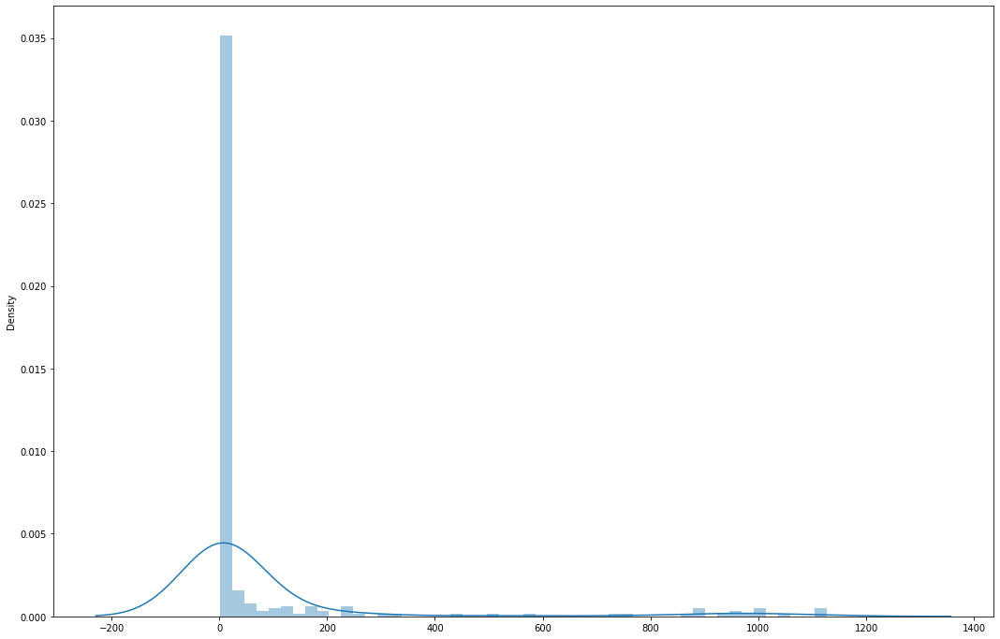

In [163]:
plt.figure(figsize=(18,12))
sns.distplot(list(dict(Counter(seq_len)).values()))

In [164]:
x_train,x_val = train_test_split(dfAllData , test_size=0.2, random_state = 10)

In [165]:
x_train["labels"].value_counts()

0    8368
1    6594
2    2133
3    1489
Name: labels, dtype: int64

In [166]:
token_train = {
    "tweet" : tokenizer.batch_encode_plus(
        x_train["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}
token_train

/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2132: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  FutureWarning,


{'tweet': {'input_ids': [[2, 673, 310, 1127, 4407, 5237, 137, 316, 27969, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 209, 1248, 16267, 72, 508, 11998, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 2750, 94, 1925, 19414, 1340, 209, 259, 1636, 2750, 94, 8373, 209, 6250, 3388, 22895, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

In [167]:
token_val = {
    "tweet" : tokenizer.batch_encode_plus(
        x_val["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}
token_val

/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2132: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  FutureWarning,


{'tweet': {'input_ids': [[2, 10995, 209, 816, 1506, 34, 6838, 5, 2824, 34, 7580, 2750, 975, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 9053, 3256, 9183, 416, 97, 2431, 396, 34, 119, 614, 9876, 7, 26, 4127, 752, 600, 13977, 23154, 4509, 3807, 387, 10144, 21885, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 597, 3668, 7576, 745, 26, 2606, 17716, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [168]:
train_data = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_train["tweet"]["input_ids"])),
}

validation_data = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_val["tweet"]["input_ids"])),
}

train_dataWithAttention = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_train["tweet"]["input_ids"])),
    "tweetMask" : tf.squeeze(tf.convert_to_tensor(token_train["tweet"]["attention_mask"]))
}

validation_dataWithAttention = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_val["tweet"]["input_ids"])),
    "tweetMask" : tf.squeeze(tf.convert_to_tensor(token_val["tweet"]["attention_mask"]))
}

In [169]:
y_train = tf.convert_to_tensor(x_train["labels"])
y_val = tf.convert_to_tensor(x_val["labels"])

In [170]:
from tensorflow.keras.utils import to_categorical

y_train = to_categorical(y_train,4)
y_val = to_categorical(y_val,4)

In [171]:
datasetTraining = (tf.data.Dataset.from_tensor_slices((train_data,y_train)).batch(64).prefetch(AUTO)).repeat()
datasetValidation = (tf.data.Dataset.from_tensor_slices((validation_data,y_val)).batch(64).prefetch(AUTO).cache())

datasetTrainingWithAttention = (tf.data.Dataset.from_tensor_slices((train_data,y_train)).batch(64).prefetch(AUTO)).repeat()
datasetValidationWithAttention =(tf.data.Dataset.from_tensor_slices((validation_data,y_val)).batch(64).prefetch(AUTO).cache())

In [172]:
METRICS = [
        tf.keras.metrics.TruePositives(name='tp'),
        tf.keras.metrics.FalsePositives(name='fp'),
        tf.keras.metrics.TrueNegatives(name='tn'),
        tf.keras.metrics.FalseNegatives(name='fn'), 
        tf.keras.metrics.CategoricalAccuracy(name='accuracy'),
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc'),
  ]
def architecture(passedModel):
  METRICS = [
        tf.keras.metrics.TruePositives(name='tp'),
        tf.keras.metrics.FalsePositives(name='fp'),
        tf.keras.metrics.TrueNegatives(name='tn'),
        tf.keras.metrics.FalseNegatives(name='fn'), 
        tf.keras.metrics.CategoricalAccuracy(name='accuracy'),
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc'),
  ]

  ids1 = tf.keras.layers.Input(shape=(99,),dtype=tf.int32,name="tweet")

  last_hidden_state, pooler_output = passedModel(ids1).to_tuple()
  layers = tf.keras.layers.Flatten()(last_hidden_state)
  layers = tf.keras.layers.Dense(units=500,activation=tf.nn.relu)(layers)
  layers = tf.keras.layers.Dropout(0.3)(layers)
  layers = tf.keras.layers.Dense(units=1024,activation=tf.nn.relu)(layers)
  layers = tf.keras.layers.Dense(128,activation=tf.nn.relu)(layers)
  fin_layer = tf.keras.layers.Dense(4,activation= tf.nn.softmax)(layers)

  final = tf.keras.Model(inputs=[ids1],outputs=[fin_layer])
  
  for layer in final.layers:
    layer.trainable = False
  for layer in final.layers[-5:]:
    layer.trainable = True 
  optimizer = tf.keras.optimizers.Adam(learning_rate=.001,clipnorm=0.001)
  final.compile(loss=tfa.losses.SigmoidFocalCrossEntropy(), optimizer=optimizer,metrics = METRICS)

  return final

In [173]:
def indoBertModel():
  return architecture(IndoBert)

In [174]:
def indoBertModelAttention():
  ids1 = tf.keras.layers.Input(shape=(99,),dtype=tf.int32,name="tweet")
  attention = tf.keras.layers.Input(shape=(99,),dtype=tf.int32,name="tweetMask")

  last_hidden_state, pooler_output = IndoBert(ids1,attention_mask=attention).to_tuple()
  layers = tf.keras.layers.Flatten()(last_hidden_state)
  layers = tf.keras.layers.Dense(units=500,activation=tf.nn.relu)(layers)
  layers = tf.keras.layers.Dropout(0.3)(layers)
  layers = tf.keras.layers.Dense(units=1024,activation=tf.nn.relu)(layers)
  layers = tf.keras.layers.Dense(128,activation=tf.nn.relu)(layers)
  fin_layer = tf.keras.layers.Dense(2,activation= tf.nn.softmax)(layers)

  final = tf.keras.Model(inputs=[ids1,attention],outputs=[fin_layer])
  
  for layer in final.layers:
    layer.trainable = False
  for layer in final.layers[-5:]:
    layer.trainable = True 
  optimizer = tf.keras.optimizers.Adam(learning_rate=.001,clipnorm=0.001)
  final.compile(loss=tfa.losses.SigmoidFocalCrossEntropy(), optimizer=optimizer,metrics = METRICS)

  return final
indoBertModelAttentionObj = indoBertModelAttention()

## Another Models ROBERTA SECTION

In [175]:
RobertaModelName = "cahya/roberta-base-indonesian-522M"
RobertaModel = TFAutoModel.from_pretrained(RobertaModelName)
RobertaTokenizer = AutoTokenizer.from_pretrained(RobertaModelName)
token_train_Roberta = {
    "tweet" : RobertaTokenizer.batch_encode_plus(
        x_train["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}

token_val_Roberta = {
    "tweet" : RobertaTokenizer.batch_encode_plus(
        x_val["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}
train_dataRoberta = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_train_Roberta["tweet"]["input_ids"]))
}
validation_dataRoberta = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_val_Roberta["tweet"]["input_ids"]))
}
train_dataRoberta = (tf.data.Dataset.from_tensor_slices((train_dataRoberta,y_train))).batch(64).prefetch(AUTO).repeat()
validation_dataRoberta = (tf.data.Dataset.from_tensor_slices((validation_dataRoberta,y_val))).batch(64).prefetch(AUTO).cache()

def robertaModel():
  model = architecture(RobertaModel)
  return model

Some layers from the model checkpoint at cahya/roberta-base-indonesian-522M were not used when initializing TFRobertaModel: ['lm_head']
- This IS expected if you are initializing TFRobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFRobertaModel were initialized from the model checkpoint at cahya/roberta-base-indonesian-522M.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFRobertaModel for predictions without further training.
/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2132: FutureWarning: The `pad_to_max_length` argum

## ANOTHER MODEL , BERT

In [176]:
BertModelName = "cahya/bert-base-indonesian-522M"
BertModel = TFAutoModel.from_pretrained(RobertaModelName)
BertModelTokenizer = AutoTokenizer.from_pretrained(RobertaModelName)
token_train_bert = {
    "tweet" : BertModelTokenizer.batch_encode_plus(
        x_train["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}

token_val_bert = {
    "tweet" : BertModelTokenizer.batch_encode_plus(
        x_val["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}
train_databert = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_train_Roberta["tweet"]["input_ids"]))
}
validation_databert = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_val_Roberta["tweet"]["input_ids"]))
}
train_databert = (tf.data.Dataset.from_tensor_slices((train_databert,y_train))).batch(64).prefetch(AUTO).repeat()
validation_databert = (tf.data.Dataset.from_tensor_slices((validation_databert,y_val))).batch(64).prefetch(AUTO).cache()

def bertModel():
  model = architecture(BertModel)
  return model

Some layers from the model checkpoint at cahya/roberta-base-indonesian-522M were not used when initializing TFRobertaModel: ['lm_head']
- This IS expected if you are initializing TFRobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFRobertaModel were initialized from the model checkpoint at cahya/roberta-base-indonesian-522M.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFRobertaModel for predictions without further training.
/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2132: FutureWarning: The `pad_to_max_length` argum

## ANOTHER MODEL GPT 2

In [177]:
GPT2Modelname = "cahya/gpt2-small-indonesian-522M"
Gpt2Model = TFAutoModel.from_pretrained(GPT2Modelname)
Gpt2ModelTokenizer = AutoTokenizer.from_pretrained(GPT2Modelname)
Gpt2ModelTokenizer.pad_token = Gpt2ModelTokenizer.eos_token
token_train_GPT2 = {
    "tweet" : Gpt2ModelTokenizer.batch_encode_plus(
        x_train["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        
        truncation = True
    ),
}

token_val_GPT2 = {
    "tweet" : Gpt2ModelTokenizer.batch_encode_plus(
        x_val["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}
train_dataGPT2 = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_train_GPT2["tweet"]["input_ids"]))
}
validation_dataGPT2 = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_val_GPT2["tweet"]["input_ids"]))
}
train_dataGPT2 = (tf.data.Dataset.from_tensor_slices((train_dataGPT2,y_train))).batch(64).prefetch(AUTO).repeat()
validation_dataGPT2 = (tf.data.Dataset.from_tensor_slices((validation_dataGPT2,y_val))).batch(64).prefetch(AUTO).cache()

def GPT2Model():
  return architecture(Gpt2Model)


All model checkpoint layers were used when initializing TFGPT2Model.

All the layers of TFGPT2Model were initialized from the model checkpoint at cahya/gpt2-small-indonesian-522M.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFGPT2Model for predictions without further training.
/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2132: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  FutureWarning,


## ANOTHER MODEL  XLMROBERTA

In [178]:
XLMRobertaName = "jplu/tf-xlm-roberta-base"
XLMRobertaMultiLingualModel = TFAutoModel.from_pretrained(XLMRobertaName)
XLMRobertaMultiLingualTokenizer = AutoTokenizer.from_pretrained(XLMRobertaName)

token_train_XLMRoberta = {
    "tweet" : XLMRobertaMultiLingualTokenizer.batch_encode_plus(
        x_train["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}

token_val_XLMRoberta = {
    "tweet" : XLMRobertaMultiLingualTokenizer.batch_encode_plus(
        x_val["tweet"].to_list(),
        max_length = 99,
        pad_to_max_length = True,
        truncation = True
    ),
}
train_dataXLMRoberta = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_train_XLMRoberta["tweet"]["input_ids"]))
}
validation_XLMRoberta = {
    "tweet" : tf.squeeze(tf.convert_to_tensor(token_val_XLMRoberta["tweet"]["input_ids"]))
}
train_dataXLMRoberta = (tf.data.Dataset.from_tensor_slices((train_dataXLMRoberta,y_train))).batch(64).prefetch(AUTO).repeat()
validation_dataXLMRoberta = (tf.data.Dataset.from_tensor_slices((validation_XLMRoberta,y_val))).batch(64).prefetch(AUTO).cache()

def XlmRoberta():
  return architecture(XLMRobertaMultiLingualModel)


Some layers from the model checkpoint at jplu/tf-xlm-roberta-base were not used when initializing TFXLMRobertaModel: ['lm_head']
- This IS expected if you are initializing TFXLMRobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFXLMRobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFXLMRobertaModel were initialized from the model checkpoint at jplu/tf-xlm-roberta-base.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFXLMRobertaModel for predictions without further training.
/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2132: FutureWarning: The `pad_to_max_length` argument i

In [179]:
def initModel():
  return bertModel(),indoBertModel(),robertaModel(),XlmRoberta(),GPT2Model()
bertmodelObj,indobertModelObj,robertaModelObj,xlmRobertaModelObj,GPT2ModelObj = initModel()


In [180]:
stepTrain = len(token_train_XLMRoberta["tweet"]["input_ids"]) // 64
stepValidation = len(token_val_XLMRoberta["tweet"]["input_ids"]) // 64

In [181]:

def trainBert(EPOCHS,CALLBACKS):
  history = bertmodelObj.fit(train_databert,steps_per_epoch =stepTrain ,validation_steps = stepValidation, validation_data=validation_databert,epochs=EPOCHS)
  return history

def trainRoberta(EPOCHS,CALLBACKS):
  history = robertaModelObj.fit(train_dataRoberta,steps_per_epoch =stepTrain ,validation_steps = stepValidation,validation_data=validation_dataRoberta,epochs=EPOCHS)
  return history

def trainXlmRoberta(EPOCHS, CALLBACKS):
  history = xlmRobertaModelObj.fit(train_dataXLMRoberta,steps_per_epoch =stepTrain ,validation_steps = stepValidation,validation_data = validation_dataXLMRoberta,epochs=EPOCHS)
  return history

def trainGpt2(EPOCHS, CALLBACKS):
  history = GPT2ModelObj.fit(train_dataGPT2,steps_per_epoch =stepTrain ,validation_steps = stepValidation, validation_data = validation_dataGPT2,epochs = EPOCHS)
  return history

def trainIndoBert(EPOCHS, CALLBACKS):
  history = indoBertModelObj.fit(datasetTraining,steps_per_epoch =stepTrain ,validation_steps = stepValidation, validation_data = datasetValidation, epochs= EPOCHS)
  return history

In [182]:
np.unique(y_train)

array([0., 1.], dtype=float32)

In [183]:
bertHistory = trainBert(5,"lol")


Epoch 1/5
290/290 [==============================] - 177s 564ms/step - loss: 0.3671 - tp: 1674.0000 - fp: 1322.0000 - tn: 54358.0000 - fn: 16886.0000 - accuracy: 0.4779 - precision: 0.5587 - recall: 0.0902 - auc: 0.7253 - val_loss: 0.2345 - val_tp: 372.0000 - val_fp: 140.0000 - val_tn: 13684.0000 - val_fn: 4236.0000 - val_accuracy: 0.5145 - val_precision: 0.7266 - val_recall: 0.0807 - val_auc: 0.7547
Epoch 2/5
247/290 [========================>.....] - ETA: 19s - loss: 0.2233 - tp: 807.0000 - fp: 169.0000 - tn: 47135.0000 - fn: 14961.0000 - accuracy: 0.4982 - precision: 0.8268 - recall: 0.0512 - auc: 0.7480

KeyboardInterrupt: ignored